# Coursera Capstone Project for Applied Data Science Capstone by IBM - Week 2
**By Arnav Ashank**

# 1. Introduction

## 1.1. Background

New york city is the most populous city in U.S. and is home to many immigrant population in New York after. Furthermore, it is the largest metropolitan area in the world with 18 million people as of 2010 with an estimated population of 18,897,109 residents.
Being a metropolitan city, New york city is also home to many restaurants which serves wide variety of cuisines. Owing to significant number of Indian expatriate population, New york City and its nearby Suburbs have handful of Indian restaurant.

So, as a part of this project Indian restaurants in New york City will be listed, visualized and rated.

**Note- Due to system constraints this notebook has been built in google colab.**

## 1.2. Problem Description

By utilizing the New york City restaurants inspection data, Indian Restaurants in New york City and their risk category will be Analyzed. Secondly, a classsifier model will be built to predict the risk categories of resturants. Furthermore, using the foursqure API we will get the ratings of Indian Restaurants in New york City.

## 1.3. Target Audience
* People looking to open new restaurants
* Restaurants
* Travelers who love Indian food

# 2. Data

For this project we will use the following data :

1. New york City restaurants inspection data from 2016-2019

*  Data source : https://data.cityofnewyork.us/api/views/43nn-pn8j/rows.csv?accessType=DOWNLOAD

*  Description : This data set contains 386000 rows and 26 coulmns with Restaurant Name, Street Name, violation descriptions along with their latitude and longitude. This data will be downloaded and used.

2. Ratings of Indian resturants for selected locality in New york City

* Data source : Fousquare API

*  Description : By using this api we will get all the ratings for Indian restaurants in selected neighborhood

# 3.Methodology

1. Collect the New york City Restaurants Inspection data from https://data.cityofnewyork.us/api/views/43nn-pn8j/rows.csv?accessType=DOWNLOAD

2. Analyze the restaurants based on their risk category

3. Building machine learning classifier model for predicting the risk category the resturants are placed

4. Filtering out all venues from the inspection data that are Indian Resturants.

5. Visualize the Indian Restaurants using folium library(python)

6. Find rating ,tips and like count for Indian Resturants using FourSquare API.

# 4. Data Processing

Load the necessarry libraries

In [0]:
# Importing relevant libraries
import numpy as np # library to handle data in a vectorized manner

import pandas as pd

import requests # library to handle requests

In [0]:
from sklearn import *
from sklearn.tree import DecisionTreeClassifier
from sklearn import metrics
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier

# import mapping rendering library
import folium 

# import JSON file handling library 

import json

# import Requests Handler library

import requests
from requests import get

# import geocoding libraries
from geopy.geocoders import Nominatim

# import package and its set of stopwords
from wordcloud import WordCloud, STOPWORDS

In [0]:
import matplotlib.pyplot as plt

In [0]:
from google.colab import files

In [4]:
uploaded = files.upload()

Saving DOHMH_New_York_City_Restaurant_Inspection_Results.csv to DOHMH_New_York_City_Restaurant_Inspection_Results.csv


In [5]:
for fn in uploaded.keys():
  print('User uploaded file "{name}" with length {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

User uploaded file "DOHMH_New_York_City_Restaurant_Inspection_Results.csv" with length 166536469 bytes


In [6]:
# Load the restaurant inspection data into dataframe 
nyc_df = pd.read_csv("DOHMH_New_York_City_Restaurant_Inspection_Results.csv")
nyc_df.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA
0,50054214,GUAC,Manhattan,179,AVENUE B,10009.0,2122544822,Mexican,12/19/2018,Establishment Closed by DOHMH. Violations wer...,04L,Evidence of mice or live mice present in facil...,Y,40.0,NaN,NaN,05/16/2020,Cycle Inspection / Re-inspection,40.727652,-73.979316,103.0,2.0,2800.0,1004904.0,1.003940e+09,MN28
1,40401912,O'NIEALS,Manhattan,174,GRAND STREET,10013.0,2129419119,American,09/20/2017,Violations were cited in the following area(s).,15F7,NaN,NaN,NaN,NaN,NaN,05/16/2020,Smoke-Free Air Act / Initial Inspection,40.719543,-73.997940,102.0,1.0,4100.0,1006973.0,1.004710e+09,MN24
2,40861946,SUPPER,Manhattan,156,EAST 2 STREET,10009.0,2124777600,Italian,03/27/2018,Violations were cited in the following area(s).,06D,"Food contact surface not properly washed, rins...",Y,17.0,NaN,NaN,05/16/2020,Cycle Inspection / Initial Inspection,40.722767,-73.985180,103.0,2.0,3002.0,1004985.0,1.003980e+09,MN22
3,50078428,CHAMPION COFFEE,Manhattan,319,EAST 14 STREET,10003.0,9172615949,Café/Coffee/Tea,12/27/2019,Violations were cited in the following area(s).,04L,Evidence of mice or live mice present in facil...,Y,18.0,NaN,NaN,05/16/2020,Cycle Inspection / Initial Inspection,40.732020,-73.984153,106.0,2.0,4800.0,1020395.0,1.009210e+09,MN21
4,50057673,YAMA RAMEN,Manhattan,60,WEST 48 STREET,10036.0,2128326688,Japanese,11/08/2018,Violations were cited in the following area(s).,04L,Evidence of mice or live mice present in facil...,Y,29.0,NaN,NaN,05/16/2020,Cycle Inspection / Initial Inspection,40.758199,-73.980320,105.0,4.0,9600.0,1034500.0,1.012630e+09,MN17


In [7]:
nyc_df.dtypes

CAMIS                      int64
DBA                       object
BORO                      object
BUILDING                  object
STREET                    object
ZIPCODE                  float64
PHONE                     object
CUISINE DESCRIPTION       object
INSPECTION DATE           object
ACTION                    object
VIOLATION CODE            object
VIOLATION DESCRIPTION     object
CRITICAL FLAG             object
SCORE                    float64
GRADE                     object
GRADE DATE                object
RECORD DATE               object
INSPECTION TYPE           object
Latitude                 float64
Longitude                float64
Community Board          float64
Council District         float64
Census Tract             float64
BIN                      float64
BBL                      float64
NTA                       object
dtype: object

In [8]:
nyc_df.columns

Index(['CAMIS', 'DBA', 'BORO', 'BUILDING', 'STREET', 'ZIPCODE', 'PHONE',
       'CUISINE DESCRIPTION', 'INSPECTION DATE', 'ACTION', 'VIOLATION CODE',
       'VIOLATION DESCRIPTION', 'CRITICAL FLAG', 'SCORE', 'GRADE',
       'GRADE DATE', 'RECORD DATE', 'INSPECTION TYPE', 'Latitude', 'Longitude',
       'Community Board', 'Council District', 'Census Tract', 'BIN', 'BBL',
       'NTA'],
      dtype='object')

In [9]:
# Create a new dataframe with necessarry columns to work with

nyc_mod_df = pd.DataFrame(columns=['CAMIS', 'DBA', 'BORO', 'BUILDING', 'STREET', 'ZIPCODE', 'PHONE',
       'CUISINE DESCRIPTION', 'INSPECTION DATE', 'ACTION', 'VIOLATION CODE',
       'VIOLATION DESCRIPTION', 'CRITICAL FLAG', 'SCORE', 'GRADE',
       'GRADE DATE', 'RECORD DATE', 'INSPECTION TYPE', 'Latitude', 'Longitude',
       'Community Board', 'Council District', 'Census Tract', 'BIN', 'BBL',
       'NTA'], data=nyc_df)
nyc_mod_df.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA
0,50054214,GUAC,Manhattan,179,AVENUE B,10009.0,2122544822,Mexican,12/19/2018,Establishment Closed by DOHMH. Violations wer...,04L,Evidence of mice or live mice present in facil...,Y,40.0,NaN,NaN,05/16/2020,Cycle Inspection / Re-inspection,40.727652,-73.979316,103.0,2.0,2800.0,1004904.0,1.003940e+09,MN28
1,40401912,O'NIEALS,Manhattan,174,GRAND STREET,10013.0,2129419119,American,09/20/2017,Violations were cited in the following area(s).,15F7,NaN,NaN,NaN,NaN,NaN,05/16/2020,Smoke-Free Air Act / Initial Inspection,40.719543,-73.997940,102.0,1.0,4100.0,1006973.0,1.004710e+09,MN24
2,40861946,SUPPER,Manhattan,156,EAST 2 STREET,10009.0,2124777600,Italian,03/27/2018,Violations were cited in the following area(s).,06D,"Food contact surface not properly washed, rins...",Y,17.0,NaN,NaN,05/16/2020,Cycle Inspection / Initial Inspection,40.722767,-73.985180,103.0,2.0,3002.0,1004985.0,1.003980e+09,MN22
3,50078428,CHAMPION COFFEE,Manhattan,319,EAST 14 STREET,10003.0,9172615949,Café/Coffee/Tea,12/27/2019,Violations were cited in the following area(s).,04L,Evidence of mice or live mice present in facil...,Y,18.0,NaN,NaN,05/16/2020,Cycle Inspection / Initial Inspection,40.732020,-73.984153,106.0,2.0,4800.0,1020395.0,1.009210e+09,MN21
4,50057673,YAMA RAMEN,Manhattan,60,WEST 48 STREET,10036.0,2128326688,Japanese,11/08/2018,Violations were cited in the following area(s).,04L,Evidence of mice or live mice present in facil...,Y,29.0,NaN,NaN,05/16/2020,Cycle Inspection / Initial Inspection,40.758199,-73.980320,105.0,4.0,9600.0,1034500.0,1.012630e+09,MN17


## Data Cleaning

In [10]:
# Dropping columns that have null values
nyc_mod_df.dropna(axis=0, how='any', inplace=True)
nyc_mod_df.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA
5,41582828,CIBO EXPRESS GOURMET MARKET/SALOTTO,Queens,0,LA GUARDIA AIRPORT,11369.0,3478675394,Sandwiches/Salads/Mixed Buffet,02/06/2020,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,2.0,A,02/06/2020,05/16/2020,Cycle Inspection / Initial Inspection,40.774414,-73.877293,480.0,21.0,33100.0,4000000.0,4.009260e+09,QN98
8,50068643,RISBO,Brooklyn,701,FLATBUSH AVENUE,11225.0,3472259115,American,03/21/2019,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,7.0,A,03/21/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.656011,-73.959948,309.0,40.0,79601.0,3115795.0,3.050480e+09,BK60
9,41272855,BOBO RESTAURANT,Manhattan,181,WEST 10 STREET,10014.0,2124882626,French,07/18/2019,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,10.0,A,07/18/2019,05/16/2020,Cycle Inspection / Re-inspection,40.734291,-74.002724,102.0,3.0,7300.0,1010840.0,1.006110e+09,MN23
14,40394701,THE END ZONE BAR,Queens,14944,14 AVENUE,11357.0,7187469654,American,01/29/2019,Violations were cited in the following area(s).,08C,Pesticide use not in accordance with label or ...,N,13.0,A,01/29/2019,05/16/2020,Cycle Inspection / Re-inspection,40.788521,-73.815045,407.0,19.0,98100.0,4105612.0,4.046600e+09,QN49
17,50064444,818 FAST FOOD,Brooklyn,818,NOSTRAND AVENUE,11216.0,3474353450,Chicken,06/07/2017,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,8.0,A,06/07/2017,05/16/2020,Pre-permit (Operational) / Initial Inspection,40.670640,-73.950440,308.0,35.0,31702.0,3032632.0,3.012610e+09,BK61


Checking to see if any null values are present

In [11]:
# Get the information about the modified dataframe
nyc_mod_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 188969 entries, 5 to 388684
Data columns (total 26 columns):
 #   Column                 Non-Null Count   Dtype  
---  ------                 --------------   -----  
 0   CAMIS                  188969 non-null  int64  
 1   DBA                    188969 non-null  object 
 2   BORO                   188969 non-null  object 
 3   BUILDING               188969 non-null  object 
 4   STREET                 188969 non-null  object 
 5   ZIPCODE                188969 non-null  float64
 6   PHONE                  188969 non-null  object 
 7   CUISINE DESCRIPTION    188969 non-null  object 
 8   INSPECTION DATE        188969 non-null  object 
 9   ACTION                 188969 non-null  object 
 10  VIOLATION CODE         188969 non-null  object 
 11  VIOLATION DESCRIPTION  188969 non-null  object 
 12  CRITICAL FLAG          188969 non-null  object 
 13  SCORE                  188969 non-null  float64
 14  GRADE                  188969 non-nu

In [ ]:
# Changing the datatype of zipcode column to int type
nyc_mod_df['ZIPCODE']=nyc_mod_df['ZIPCODE'].astype(int)

# Changing the datatype of inspection date column to datetime type
nyc_mod_df['INSPECTION DATE']=pd.to_datetime(nyc_mod_df['INSPECTION DATE'],format='%m/%d/%Y')

nyc_mod_df['Inspection Year']=nyc_mod_df['INSPECTION DATE'].dt.year

nyc_copy['Inspection Month']=nyc_copy['INSPECTION DATE'].dt.month

In [13]:
nyc_mod_df.describe()

,CAMIS,ZIPCODE,SCORE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL
count,1.889690e+05,188969.000000,188969.000000,188969.000000,188969.000000,188969.000000,188969.000000,188969.000000,1.889690e+05,1.889690e+05
mean,4.602827e+07,10664.491245,12.946901,40.728421,-73.945127,245.532595,19.946314,28336.877472,2.479629e+06,2.418465e+09
std,4.418988e+06,593.841374,8.170406,0.068668,0.074397,130.199877,15.951977,30155.994228,1.342832e+06,1.306615e+09
min,3.007544e+07,10000.000000,-1.000000,40.508069,-74.248708,101.000000,1.000000,100.000000,1.000000e+06,1.000000e+09
25%,4.137760e+07,10022.000000,9.000000,40.687584,-73.989773,105.000000,4.000000,7800.000000,1.040755e+06,1.010600e+09
50%,5.000486e+07,10466.000000,12.000000,40.733281,-73.961347,301.000000,19.000000,15900.000000,3.001207e+06,3.001610e+09
75%,5.005650e+07,11226.000000,13.000000,40.762279,-73.905725,318.000000,34.000000,39800.000000,3.401675e+06,3.086960e+09
max,5.010416e+07,12345.000000,98.000000,40.912822,-73.700928,595.000000,51.000000,162100.000000,5.799501e+06,5.270001e+09


Now the dataframe is ready for further processing. However, before proceeding further let's add a risk column by binning the inspection scores into following categories using the guidelines in https://www1.nyc.gov/site/doh/business/food-operators/letter-grading-for-restaurants.page. Let's create three categories for ease of classification:
1.   Low Risk - Inpection Score between -2 to 13
2.   Medium Risk - Inpection Score between 13 to 27
3.   High Risk - Inspection Score between 27 to 100

In [18]:
# Create risk category bins
bins = [-2, 13, 27, 100]
labels =["Low Risk","Medium Risk","High Risk"]
nyc_mod_df['Risk'] = pd.cut(nyc_mod_df['SCORE'], bins,labels=labels)
nyc_mod_df.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,Risk
5,41582828,CIBO EXPRESS GOURMET MARKET/SALOTTO,Queens,0,LA GUARDIA AIRPORT,11369,3478675394,Sandwiches/Salads/Mixed Buffet,02/06/2020,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,2.0,A,02/06/2020,05/16/2020,Cycle Inspection / Initial Inspection,40.774414,-73.877293,480.0,21.0,33100.0,4000000.0,4.009260e+09,QN98,Low Risk
8,50068643,RISBO,Brooklyn,701,FLATBUSH AVENUE,11225,3472259115,American,03/21/2019,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,7.0,A,03/21/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.656011,-73.959948,309.0,40.0,79601.0,3115795.0,3.050480e+09,BK60,Low Risk
9,41272855,BOBO RESTAURANT,Manhattan,181,WEST 10 STREET,10014,2124882626,French,07/18/2019,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,10.0,A,07/18/2019,05/16/2020,Cycle Inspection / Re-inspection,40.734291,-74.002724,102.0,3.0,7300.0,1010840.0,1.006110e+09,MN23,Low Risk
14,40394701,THE END ZONE BAR,Queens,14944,14 AVENUE,11357,7187469654,American,01/29/2019,Violations were cited in the following area(s).,08C,Pesticide use not in accordance with label or ...,N,13.0,A,01/29/2019,05/16/2020,Cycle Inspection / Re-inspection,40.788521,-73.815045,407.0,19.0,98100.0,4105612.0,4.046600e+09,QN49,Low Risk
17,50064444,818 FAST FOOD,Brooklyn,818,NOSTRAND AVENUE,11216,3474353450,Chicken,06/07/2017,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,8.0,A,06/07/2017,05/16/2020,Pre-permit (Operational) / Initial Inspection,40.670640,-73.950440,308.0,35.0,31702.0,3032632.0,3.012610e+09,BK61,Low Risk


In [19]:
nyc_mod_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 188969 entries, 5 to 388684
Data columns (total 27 columns):
 #   Column                 Non-Null Count   Dtype   
---  ------                 --------------   -----   
 0   CAMIS                  188969 non-null  int64   
 1   DBA                    188969 non-null  object  
 2   BORO                   188969 non-null  object  
 3   BUILDING               188969 non-null  object  
 4   STREET                 188969 non-null  object  
 5   ZIPCODE                188969 non-null  int64   
 6   PHONE                  188969 non-null  object  
 7   CUISINE DESCRIPTION    188969 non-null  object  
 8   INSPECTION DATE        188969 non-null  object  
 9   ACTION                 188969 non-null  object  
 10  VIOLATION CODE         188969 non-null  object  
 11  VIOLATION DESCRIPTION  188969 non-null  object  
 12  CRITICAL FLAG          188969 non-null  object  
 13  SCORE                  188969 non-null  float64 
 14  GRADE               

# 5. Data Visulaization

In [21]:
df_risk = nyc_mod_df.groupby('Risk', axis=0).count()
df_risk.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA
Risk,,,,,,,,,,,,,,,,,,,,,,,,,,
Low Risk,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136,154136
Medium Risk,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762,25762
High Risk,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071,9071


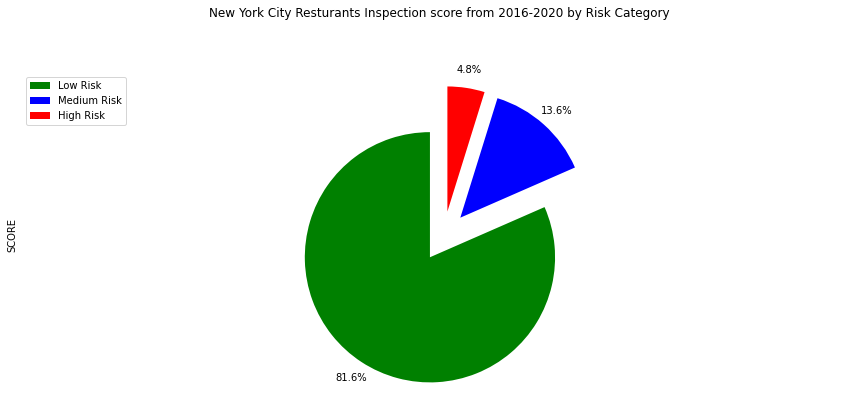

In [23]:
colors_list = ['green', 'blue', 'red']
explode_list = [0.2, 0.2, 0.2] # ratio for offsetting each wedge.

df_risk['SCORE'].plot(kind='pie',
                            figsize=(15, 6),
                            autopct='%1.1f%%', 
                            startangle=90,    
                            shadow=False,       
                            labels=None,         # turn off labels on pie chart
                            pctdistance=1.15,    # the ratio between the center of each pie slice and the start of the text generated by autopct 
                            colors=colors_list,  # add custom colors
                            explode=explode_list 
                            )

plt.title('New York City Resturants Inspection score from 2016-2020 by Risk Category', y=1.15) 

plt.axis('equal') 

# add legend
plt.legend(labels=df_risk.index, loc='upper left') 

plt.show()

As it can be seen from the above pie chart that majority of (~82%) are low risk categories. This shows either the New York City officials are very strict or the retsuarants maintain a very high standard!!.

Now let's visualize how many number of resturants are in each risk category from 2016-2020

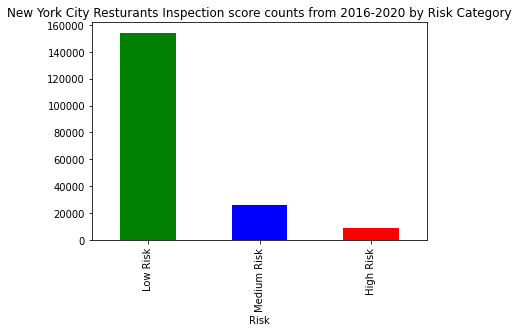

In [24]:
df_risk['SCORE'].plot.bar(color = colors_list)

plt.title('New York City Resturants Inspection score counts from 2016-2020 by Risk Category')

plt.xlabel("Risk");

A bit more detail on the counts

In [27]:
nyc_df_year = nyc_mod_df.groupby(['Risk','Inspection Year'])['SCORE'].count()
nyc_df_year.head(20)

Risk         Inspection Year
Low Risk     2014                   2
             2015                  39
             2016                7147
             2017               31571
             2018               47630
             2019               56039
             2020               11708
Medium Risk  2014                   0
             2015                   3
             2016                1029
             2017                4461
             2018                8091
             2019                9929
             2020                2249
High Risk    2014                   5
             2015                   0
             2016                 255
             2017                1150
             2018                2725
             2019                3849
Name: SCORE, dtype: int64

In [0]:
un_nyc_df = nyc_df_year.unstack()

In [29]:
df_all_year = un_nyc_df.T
df_all_year

Risk,Low Risk,Medium Risk,High Risk
Inspection Year,,,
2014,2,0,5
2015,39,3,0
2016,7147,1029,255
2017,31571,4461,1150
2018,47630,8091,2725
2019,56039,9929,3849
2020,11708,2249,1087


In [30]:
nyc_mod_df.groupby(['Inspection Year'])['Risk'].value_counts(normalize=True)

Inspection Year  Risk       
2014             High Risk      0.714286
                 Low Risk       0.285714
2015             Low Risk       0.928571
                 Medium Risk    0.071429
2016             Low Risk       0.847705
                 Medium Risk    0.122050
                 High Risk      0.030246
2017             Low Risk       0.849094
                 Medium Risk    0.119977
                 High Risk      0.030929
2018             Low Risk       0.814940
                 Medium Risk    0.138435
                 High Risk      0.046624
2019             Low Risk       0.802656
                 Medium Risk    0.142215
                 High Risk      0.055130
2020             Low Risk       0.778250
                 Medium Risk    0.149495
                 High Risk      0.072255
Name: Risk, dtype: float64

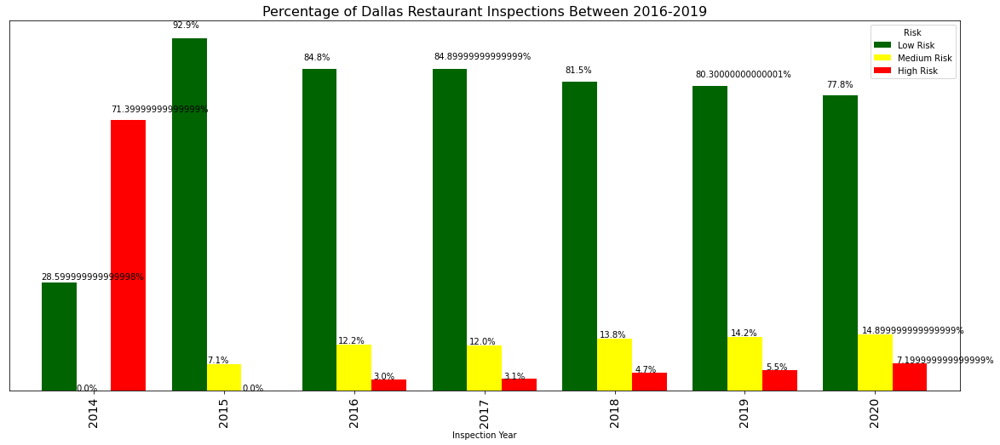

In [31]:
# Convert the numbers into percentages of the total number of respondents.

df_risk_percent = df_all_year.div(df_all_year.sum(1), axis=0).round(3)*100
#df_risk_percent = ((df_all_year / 36093) * 100).round(2)

# Create the plot
ax = df_risk_percent.plot(kind='bar',
                       figsize = (20, 8),
                       width = 0.8,
                       color = ['#006400', '#FFFF00', '#FF0000'],
                       fontsize = 14)

# Add title to the plot
plt.title('Percentage of New York City Restaurant Inspections Between 2014-2020', fontsize=16)

# See link https://stackoverflow.com/questions/14088687/how-to-change-plot-background-color/23907866
ax.set_facecolor((1.0, 1.0, 1.0))

# See link https://stackoverflow.com/questions/40705614/hide-axis-label-only-not-entire-axis-in-pandas-plot
y_axis = ax.axes.get_yaxis()
y_axis.set_visible(False)

# See link https://stackoverflow.com/questions/25447700/annotate-bars-with-values-on-pandas-bar-plots
for i in ax.patches:
    ax.annotate(str(i.get_height()) + '%', (i.get_x() * 1.005, i.get_height() * 1.03))
    
plt.show()

Now that's very much appealing. Let us now visualize the Inspection score distribution in each year

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


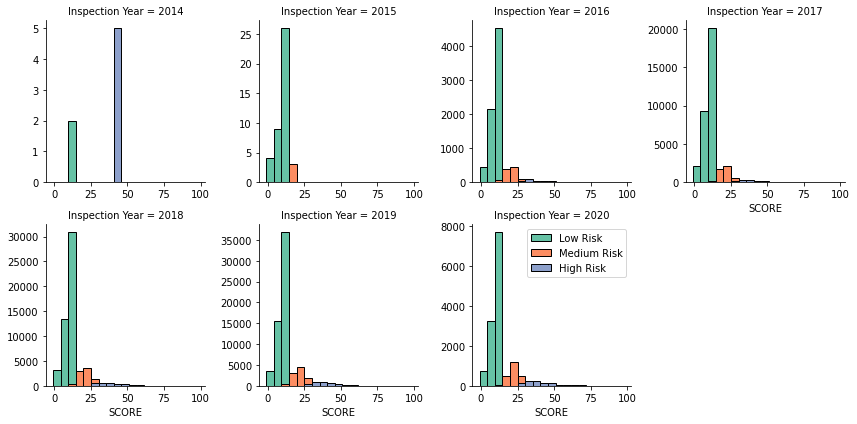

In [32]:
import seaborn as sns

bins = np.linspace(nyc_mod_df['SCORE'].min(), nyc_mod_df['SCORE'].max(), 20)
g = sns.FacetGrid(nyc_mod_df, col="Inspection Year", hue="Risk", palette="Set2", col_wrap=4,sharex=False,sharey=False)
g.map(plt.hist, 'SCORE', bins=bins, ec="k")

g.axes[-1].legend()
plt.show()
g.savefig("Overall_Inspection_Bar.png")

Let us also visualize during which days of the week most inspections were conducted in each year

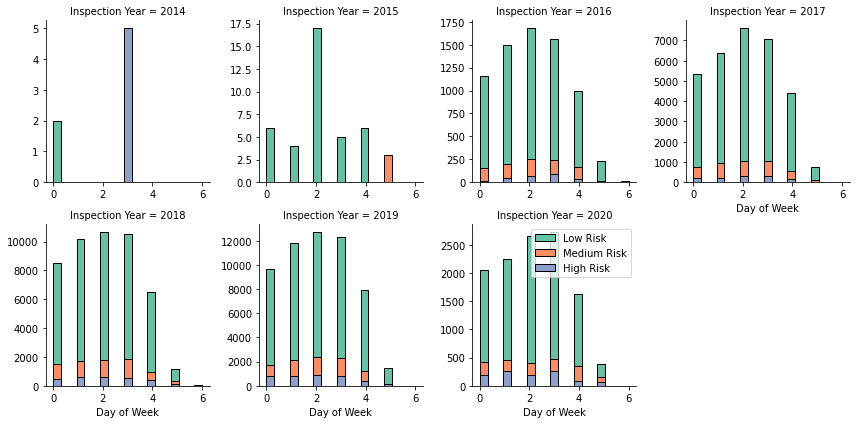

In [33]:
nyc_mod_df['Day of Week'] = nyc_mod_df['INSPECTION DATE'].dt.dayofweek
bins = np.linspace(nyc_mod_df['Day of Week'].min(), nyc_mod_df['Day of Week'].max(), 20)
g = sns.FacetGrid(nyc_mod_df, col="Inspection Year", hue="Risk", palette="Set2", col_wrap=4,sharex=False,sharey=False)
g.map(plt.hist, 'Day of Week', bins=bins, ec="k")
g.axes[-1].legend()
plt.show()
g.savefig("Overall_Inspection_DOW_bar.png")

It can be seen from the above graph that most of the inspections were conducted during the weekends. This is expected as more customers are expected during weekends and the restaurants are pushed to their limit.

Since the aim of the project is to analyze the performance of Indian resturants in New York City, we need to find the Indian restaurants from the above dataframe to proceed further. A simple google search revealed that most of the Indian resturants in New York the keywords such as India, etc., in their name. So let's find out those.

In [34]:
nyc_mod_df['CUISINE DESCRIPTION'].value_counts()

American              40942
Chinese               18852
Café/Coffee/Tea       10565
Pizza                  8383
Italian                7675
                      ...  
Fruits/Vegetables        30
Nuts/Confectionary       27
Czech                    26
Southwestern             20
Basque                    6
Name: CUISINE DESCRIPTION, Length: 83, dtype: int64

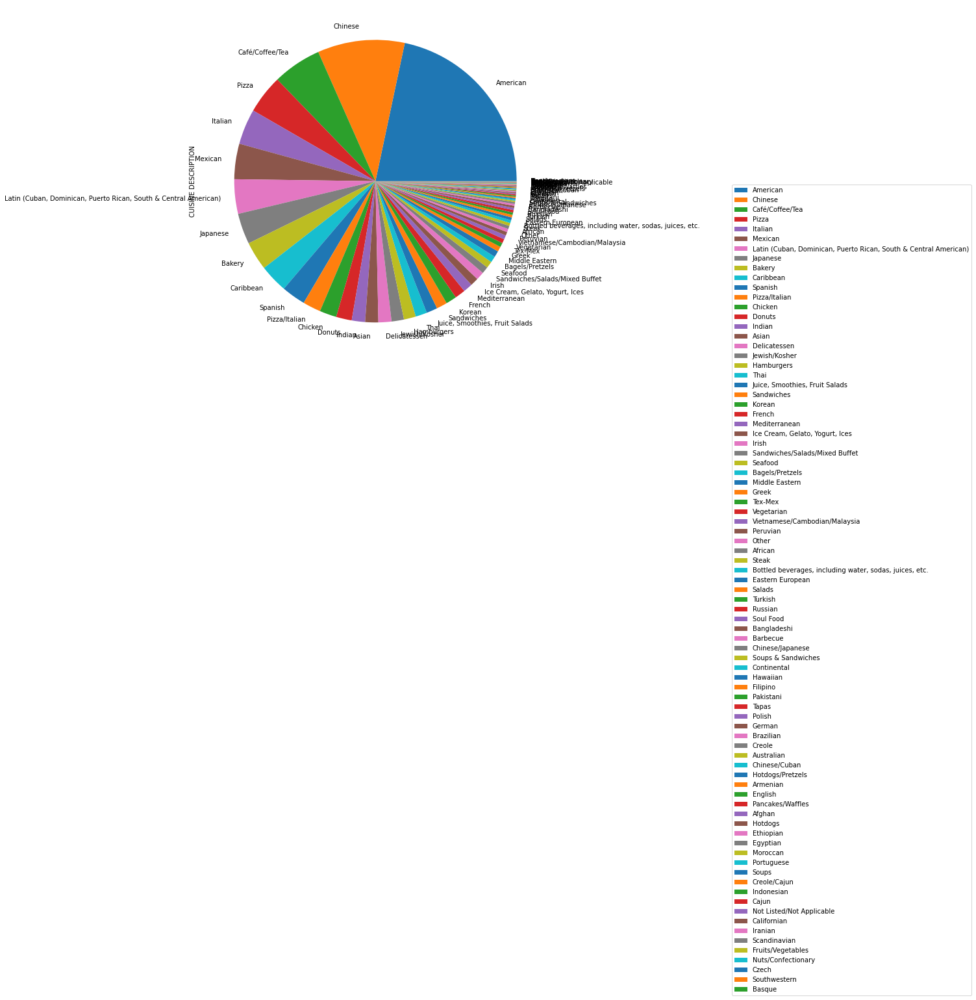

In [35]:
k=nyc_mod_df['CUISINE DESCRIPTION'].value_counts()
k.plot(kind='pie',figsize=(20,10),legend=True)
plt.legend(loc=0,bbox_to_anchor=(1.5,0.5));

In [36]:
indian_df = nyc_mod_df[nyc_mod_df['CUISINE DESCRIPTION']=='Indian']
indian_df

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,Risk,Inspection Year,Day of Week
556,41631065,AYNA AGRA,Queens,21335,39 AVENUE,11361,7182251201,Indian,2019-07-25,Violations were cited in the following area(s).,06D,"Food contact surface not properly washed, rins...",Y,13.0,A,07/25/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.765365,-73.771666,411.0,19.0,112300.0,4137572.0,4.062380e+09,QN46,Low Risk,2019,3
629,50070585,KING KABAB,Queens,16709,HILLSIDE AVE,11432,7185264968,Indian,2019-10-10,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,9.0,A,10/10/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.709806,-73.795436,408.0,24.0,45400.0,4210476.0,4.098390e+09,QN35,Low Risk,2019,3
1048,50045803,PUNJABI KABAB AND GYRO,Queens,10803,101ST AVE,11416,7187099919,Indian,2017-03-13,Violations were cited in the following area(s).,08A,Facility not vermin proof. Harborage or condit...,N,14.0,B,03/13/2017,05/16/2020,Cycle Inspection / Re-inspection,40.687314,-73.835288,409.0,28.0,11000.0,4197917.0,4.094100e+09,QN54,Medium Risk,2017,0
1082,50045803,PUNJABI KABAB AND GYRO,Queens,10803,101ST AVE,11416,7187099919,Indian,2020-01-23,Violations were cited in the following area(s).,09C,Food contact surface not properly maintained.,N,8.0,A,01/23/2020,05/16/2020,Cycle Inspection / Initial Inspection,40.687314,-73.835288,409.0,28.0,11000.0,4197917.0,4.094100e+09,QN54,Low Risk,2020,3
1266,50091820,NYC FALAFEL CO,Manhattan,201,ALLEN STREET,10002,6469186877,Indian,2019-05-29,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,6.0,A,05/29/2019,05/16/2020,Pre-permit (Operational) / Re-inspection,40.722523,-73.988820,103.0,1.0,3601.0,1005543.0,1.004170e+09,MN27,Low Risk,2019,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
388449,40793607,CAFE SPICE,Manhattan,0,GRAND CENTRAL TERMINAL,10017,6462271300,Indian,2019-05-21,Violations were cited in the following area(s).,04L,Evidence of mice or live mice present in facil...,Y,10.0,A,05/21/2019,05/16/2020,Cycle Inspection / Re-inspection,40.752514,-73.977305,105.0,4.0,9200.0,1035381.0,1.012800e+09,MN19,Low Risk,2019,1
388538,50018149,101 MEAT SHOP,Queens,11601,101ST AVE,11419,7184419333,Indian,2018-02-21,Violations were cited in the following area(s).,10B,Plumbing not properly installed or maintained;...,N,9.0,A,02/21/2018,05/16/2020,Cycle Inspection / Re-inspection,40.689274,-73.828393,409.0,28.0,12000.0,4441339.0,4.094510e+09,QN54,Low Risk,2018,2
388544,41593315,MUMTAZ,Manhattan,1582,YORK AVENUE,10028,2128794797,Indian,2017-03-06,Establishment re-opened by DOHMH,10F,Non-food contact surface improperly constructe...,N,5.0,P,03/06/2017,05/16/2020,Cycle Inspection / Reopening Inspection,40.774229,-73.948348,108.0,5.0,13600.0,1051180.0,1.015800e+09,MN32,Low Risk,2017,0
388620,50036869,PAK LAHORI CHILLI,Brooklyn,1026,CONEY ISLAND AVENUE,11230,7188591400,Indian,2016-10-21,Violations were cited in the following area(s).,02G,Cold food item held above 41º F (smoked fish a...,Y,23.0,B,10/21/2016,05/16/2020,Cycle Inspection / Re-inspection,40.632653,-73.966894,314.0,40.0,48200.0,3128204.0,3.054290e+09,BK42,Medium Risk,2016,4


In [37]:
indian_df.reset_index(drop=True, inplace=True)
indian_df.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,Risk,Inspection Year,Day of Week
0,41631065,AYNA AGRA,Queens,21335,39 AVENUE,11361,7182251201,Indian,2019-07-25,Violations were cited in the following area(s).,06D,"Food contact surface not properly washed, rins...",Y,13.0,A,07/25/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.765365,-73.771666,411.0,19.0,112300.0,4137572.0,4.062380e+09,QN46,Low Risk,2019,3
1,50070585,KING KABAB,Queens,16709,HILLSIDE AVE,11432,7185264968,Indian,2019-10-10,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,9.0,A,10/10/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.709806,-73.795436,408.0,24.0,45400.0,4210476.0,4.098390e+09,QN35,Low Risk,2019,3
2,50045803,PUNJABI KABAB AND GYRO,Queens,10803,101ST AVE,11416,7187099919,Indian,2017-03-13,Violations were cited in the following area(s).,08A,Facility not vermin proof. Harborage or condit...,N,14.0,B,03/13/2017,05/16/2020,Cycle Inspection / Re-inspection,40.687314,-73.835288,409.0,28.0,11000.0,4197917.0,4.094100e+09,QN54,Medium Risk,2017,0
3,50045803,PUNJABI KABAB AND GYRO,Queens,10803,101ST AVE,11416,7187099919,Indian,2020-01-23,Violations were cited in the following area(s).,09C,Food contact surface not properly maintained.,N,8.0,A,01/23/2020,05/16/2020,Cycle Inspection / Initial Inspection,40.687314,-73.835288,409.0,28.0,11000.0,4197917.0,4.094100e+09,QN54,Low Risk,2020,3
4,50091820,NYC FALAFEL CO,Manhattan,201,ALLEN STREET,10002,6469186877,Indian,2019-05-29,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,6.0,A,05/29/2019,05/16/2020,Pre-permit (Operational) / Re-inspection,40.722523,-73.988820,103.0,1.0,3601.0,1005543.0,1.004170e+09,MN27,Low Risk,2019,2


In [ ]:
indian_df.shape

So there are 2883 entries from our search. However, those are all not unique as they contain inspection details from 2016-2020 for the same restaurants.

Let us visualize the inspection score of Indian retuarants from 2016-2020 based on their risk category.

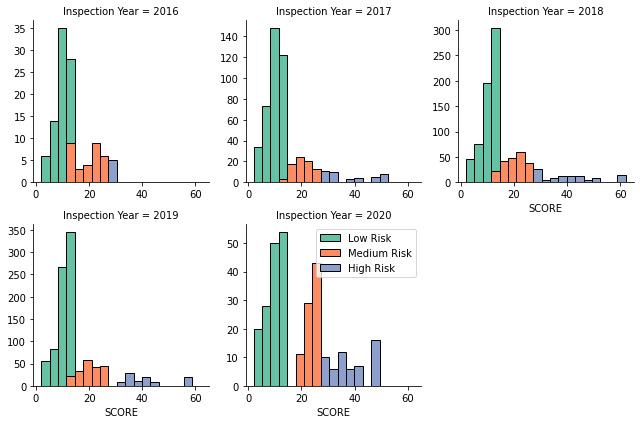

In [38]:
bins = np.linspace(indian_df['SCORE'].min(), indian_df['SCORE'].max(), 20)
g = sns.FacetGrid(indian_df, col="Inspection Year", hue="Risk", palette="Set2", col_wrap=3,sharex=False,sharey=False)
g.map(plt.hist, 'SCORE', bins=bins, ec="k")

g.axes[-1].legend()
plt.show()
g.savefig("Indian_Restaurants_bar.png")

Let us group the above results based on restaurant name, risk and the Inspection Score

In [39]:
indian_year = indian_df.groupby(['DBA','Risk','Inspection Year'])['SCORE'].count()
indian_year.head(100)

DBA       Risk         Inspection Year
1 DARBAR  Low Risk     2016               3
                       2017               3
                       2018               2
                       2019               3
                       2020               0
                                         ..
ADDA      Medium Risk  2016               0
                       2017               0
                       2018               0
                       2019               0
                       2020               0
Name: SCORE, Length: 100, dtype: int64

In [40]:
df_indian_risk = indian_year.groupby('Risk', axis=0).count()
df_indian_risk.head()

Risk
Low Risk       1415
Medium Risk    1415
High Risk      1415
Name: SCORE, dtype: int64

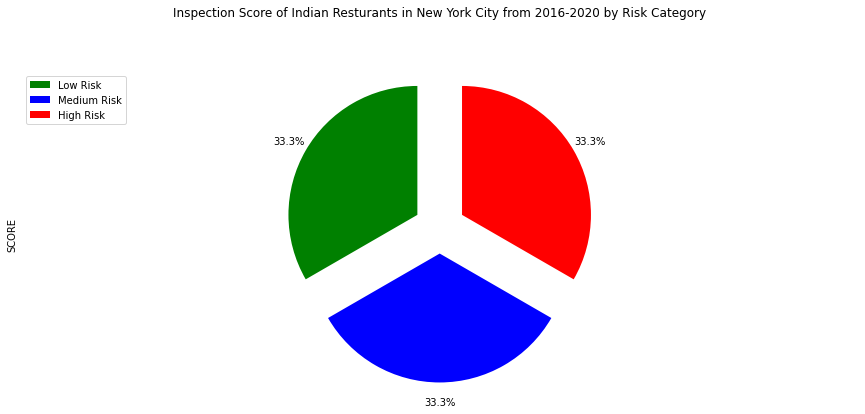

<Figure size 432x288 with 0 Axes>

In [41]:
colors_list = ['green', 'blue', 'red']
explode_list = [0.2, 0.2, 0.2] # ratio for each continent with which to offset each wedge.

df_indian_risk.plot(kind='pie',
                            figsize=(15, 6),
                            autopct='%1.1f%%', 
                            startangle=90,    
                            shadow=False,       
                            labels=None,         # turn off labels on pie chart
                            pctdistance=1.15,    # the ratio between the center of each pie slice and the start of the text generated by autopct 
                            colors=colors_list,  # add custom colors
                            explode=explode_list # 'explode' lowest 3 continents
                            )

# scale the title up by 12% to match pctdistance
plt.title('Inspection Score of Indian Resturants in New York City from 2016-2020 by Risk Category', y=1.15) 

plt.axis('equal') 

# add legend
plt.legend(labels=df_indian_risk.index, loc='upper left') 

plt.show()

plt.savefig("Indian_Restaurants_pie.png")

Thus, ~33.3% of Indian restaurants were classified as Low risk from 2016-2020 which is a not good number. 

In [0]:
import seaborn as sb

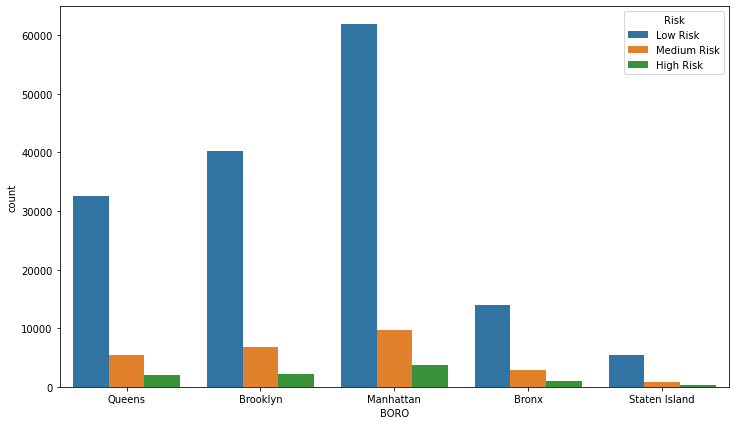

In [46]:
plt.figure(figsize=[12,7])
sb.countplot(data=nyc_mod_df,x='BORO',hue='Risk');

Count of restaurants in risk category grouped by Neighborhood.

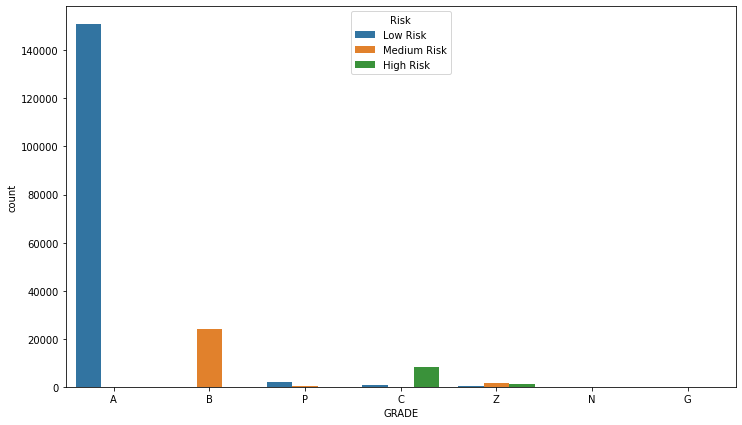

In [47]:
plt.figure(figsize=[12,7])
sb.countplot(data=nyc_mod_df,x='GRADE',hue='Risk');

Count of restaurants in risk category grouped by Grade.

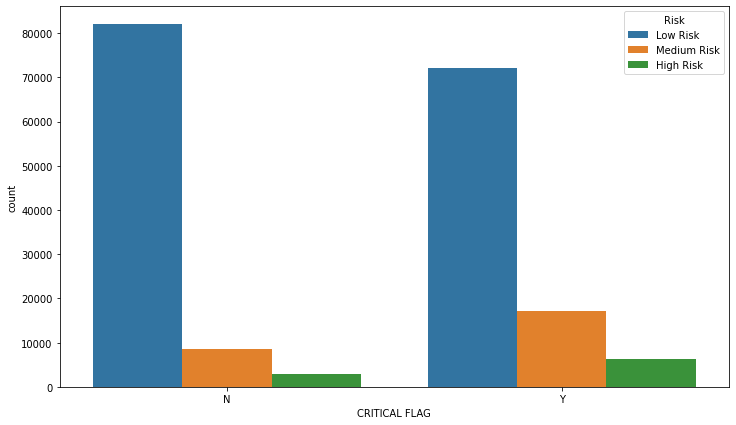

In [48]:
plt.figure(figsize=[12,7])
sb.countplot(data=nyc_mod_df,x='CRITICAL FLAG',hue='Risk');

Count of restaurants in risk category grouped by Critical Flag.

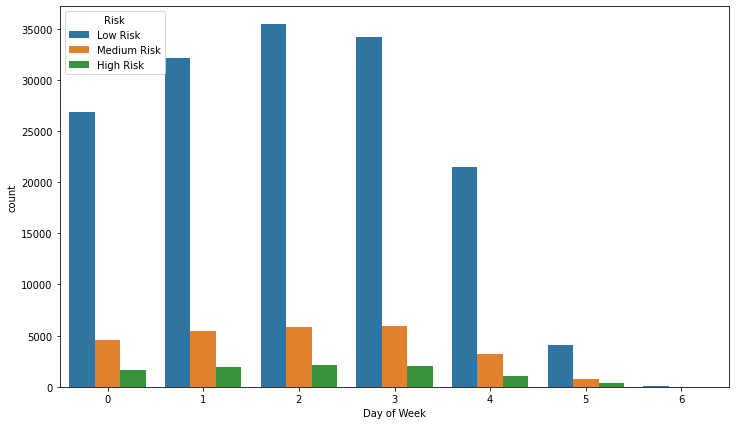

In [49]:
plt.figure(figsize=[12,7])
sb.countplot(data=nyc_mod_df,x='Day of Week',hue='Risk');

Count of restaurants in risk category grouped by Day of week.

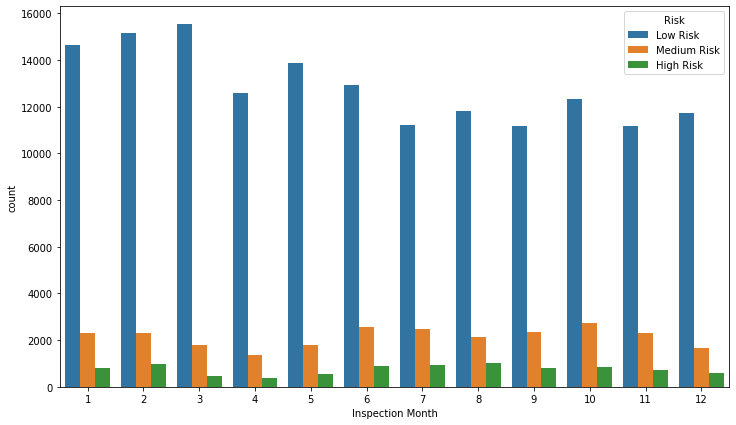

In [54]:
plt.figure(figsize=[12,7])
sb.countplot(data=nyc_copy,x='Inspection Month',hue='Risk');

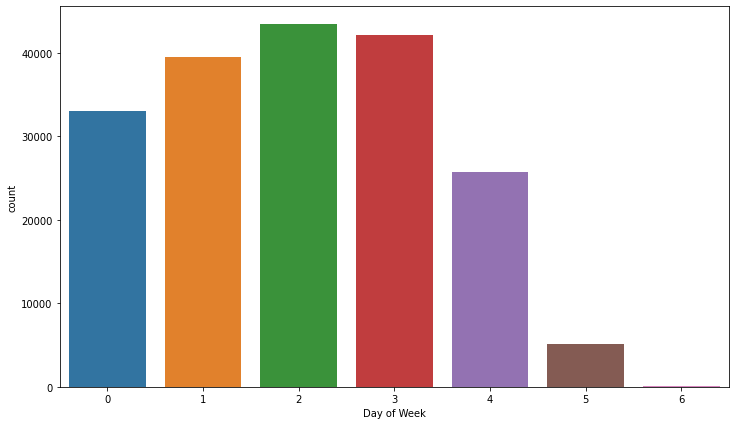

In [50]:
plt.figure(figsize=[12,7])
sb.countplot(data=nyc_mod_df,x='Day of Week');

Let us visulaize the violation descriptions of the indian restaurants from 2016-2020 using word cloud

In [0]:
# Set stop words

stopwords = set(STOPWORDS)

# Create a list of violation description

violation_list = indian_df['VIOLATION DESCRIPTION'].tolist()

word_string = " ".join(str(s) for s in violation_list)

wordcloud = WordCloud(background_color='white', max_words=2000,stopwords=stopwords).generate(word_string)

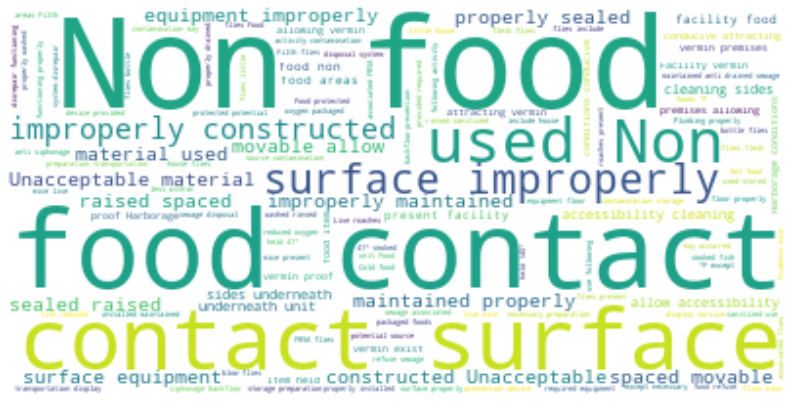

<Figure size 432x288 with 0 Axes>

In [43]:
stopwords.add('Moderate risk') 
stopwords.add('risk')
stopwords.add('Moderate')
# re-generate the word cloud
wordcloud.generate(word_string)

fig = plt.figure()
fig.set_figwidth(14) # set width
fig.set_figheight(18) # set height

# display the cloud
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()
plt.savefig("Indian_Word_Cloud.png")

# 6. Modelling

Since the restaurants are categorized into three categories let us employ the classfication algorithm such as decision tree model and random forest model to predict the risk category.

In [44]:
indian_df.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,Risk,Inspection Year,Day of Week
0,41631065,AYNA AGRA,Queens,21335,39 AVENUE,11361,7182251201,Indian,2019-07-25,Violations were cited in the following area(s).,06D,"Food contact surface not properly washed, rins...",Y,13.0,A,07/25/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.765365,-73.771666,411.0,19.0,112300.0,4137572.0,4.062380e+09,QN46,Low Risk,2019,3
1,50070585,KING KABAB,Queens,16709,HILLSIDE AVE,11432,7185264968,Indian,2019-10-10,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,9.0,A,10/10/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.709806,-73.795436,408.0,24.0,45400.0,4210476.0,4.098390e+09,QN35,Low Risk,2019,3
2,50045803,PUNJABI KABAB AND GYRO,Queens,10803,101ST AVE,11416,7187099919,Indian,2017-03-13,Violations were cited in the following area(s).,08A,Facility not vermin proof. Harborage or condit...,N,14.0,B,03/13/2017,05/16/2020,Cycle Inspection / Re-inspection,40.687314,-73.835288,409.0,28.0,11000.0,4197917.0,4.094100e+09,QN54,Medium Risk,2017,0
3,50045803,PUNJABI KABAB AND GYRO,Queens,10803,101ST AVE,11416,7187099919,Indian,2020-01-23,Violations were cited in the following area(s).,09C,Food contact surface not properly maintained.,N,8.0,A,01/23/2020,05/16/2020,Cycle Inspection / Initial Inspection,40.687314,-73.835288,409.0,28.0,11000.0,4197917.0,4.094100e+09,QN54,Low Risk,2020,3
4,50091820,NYC FALAFEL CO,Manhattan,201,ALLEN STREET,10002,6469186877,Indian,2019-05-29,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,6.0,A,05/29/2019,05/16/2020,Pre-permit (Operational) / Re-inspection,40.722523,-73.988820,103.0,1.0,3601.0,1005543.0,1.004170e+09,MN27,Low Risk,2019,2


In [51]:
# Copy dataframe so that the original datframe is untouched

nyc_copy=nyc_mod_df.copy()
nyc_copy.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,Risk,Inspection Year,Day of Week
5,41582828,CIBO EXPRESS GOURMET MARKET/SALOTTO,Queens,0,LA GUARDIA AIRPORT,11369,3478675394,Sandwiches/Salads/Mixed Buffet,2020-02-06,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,2.0,A,02/06/2020,05/16/2020,Cycle Inspection / Initial Inspection,40.774414,-73.877293,480.0,21.0,33100.0,4000000.0,4.009260e+09,QN98,Low Risk,2020,3
8,50068643,RISBO,Brooklyn,701,FLATBUSH AVENUE,11225,3472259115,American,2019-03-21,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,7.0,A,03/21/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.656011,-73.959948,309.0,40.0,79601.0,3115795.0,3.050480e+09,BK60,Low Risk,2019,3
9,41272855,BOBO RESTAURANT,Manhattan,181,WEST 10 STREET,10014,2124882626,French,2019-07-18,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,10.0,A,07/18/2019,05/16/2020,Cycle Inspection / Re-inspection,40.734291,-74.002724,102.0,3.0,7300.0,1010840.0,1.006110e+09,MN23,Low Risk,2019,3
14,40394701,THE END ZONE BAR,Queens,14944,14 AVENUE,11357,7187469654,American,2019-01-29,Violations were cited in the following area(s).,08C,Pesticide use not in accordance with label or ...,N,13.0,A,01/29/2019,05/16/2020,Cycle Inspection / Re-inspection,40.788521,-73.815045,407.0,19.0,98100.0,4105612.0,4.046600e+09,QN49,Low Risk,2019,1
17,50064444,818 FAST FOOD,Brooklyn,818,NOSTRAND AVENUE,11216,3474353450,Chicken,2017-06-07,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,8.0,A,06/07/2017,05/16/2020,Pre-permit (Operational) / Initial Inspection,40.670640,-73.950440,308.0,35.0,31702.0,3032632.0,3.012610e+09,BK61,Low Risk,2017,2


In [52]:
nyc_copy.reset_index(drop=True, inplace=True)
nyc_copy.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,Risk,Inspection Year,Day of Week
0,41582828,CIBO EXPRESS GOURMET MARKET/SALOTTO,Queens,0,LA GUARDIA AIRPORT,11369,3478675394,Sandwiches/Salads/Mixed Buffet,2020-02-06,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,2.0,A,02/06/2020,05/16/2020,Cycle Inspection / Initial Inspection,40.774414,-73.877293,480.0,21.0,33100.0,4000000.0,4.009260e+09,QN98,Low Risk,2020,3
1,50068643,RISBO,Brooklyn,701,FLATBUSH AVENUE,11225,3472259115,American,2019-03-21,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,7.0,A,03/21/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.656011,-73.959948,309.0,40.0,79601.0,3115795.0,3.050480e+09,BK60,Low Risk,2019,3
2,41272855,BOBO RESTAURANT,Manhattan,181,WEST 10 STREET,10014,2124882626,French,2019-07-18,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,10.0,A,07/18/2019,05/16/2020,Cycle Inspection / Re-inspection,40.734291,-74.002724,102.0,3.0,7300.0,1010840.0,1.006110e+09,MN23,Low Risk,2019,3
3,40394701,THE END ZONE BAR,Queens,14944,14 AVENUE,11357,7187469654,American,2019-01-29,Violations were cited in the following area(s).,08C,Pesticide use not in accordance with label or ...,N,13.0,A,01/29/2019,05/16/2020,Cycle Inspection / Re-inspection,40.788521,-73.815045,407.0,19.0,98100.0,4105612.0,4.046600e+09,QN49,Low Risk,2019,1
4,50064444,818 FAST FOOD,Brooklyn,818,NOSTRAND AVENUE,11216,3474353450,Chicken,2017-06-07,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,8.0,A,06/07/2017,05/16/2020,Pre-permit (Operational) / Initial Inspection,40.670640,-73.950440,308.0,35.0,31702.0,3032632.0,3.012610e+09,BK61,Low Risk,2017,2


In [0]:
nyc_copy['Inspection Month']=nyc_copy['INSPECTION DATE'].dt.month

In [55]:
nyc_copy['INSPECTION TYPE'].value_counts()

Cycle Inspection / Re-inspection                    87788
Cycle Inspection / Initial Inspection               78533
Pre-permit (Operational) / Re-inspection            11053
Pre-permit (Operational) / Initial Inspection        8004
Cycle Inspection / Reopening Inspection              3071
Pre-permit (Operational) / Reopening Inspection       515
Pre-permit (Operational) / Compliance Inspection        5
Name: INSPECTION TYPE, dtype: int64

In [56]:
# Label encoding categorical columns

nyc_copy['Risk'].replace(to_replace=['Low Risk','Medium Risk','High Risk'], value=[1,2,3],inplace=True)
nyc_copy.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,Risk,Inspection Year,Day of Week,Inspection Month
0,41582828,CIBO EXPRESS GOURMET MARKET/SALOTTO,Queens,0,LA GUARDIA AIRPORT,11369,3478675394,Sandwiches/Salads/Mixed Buffet,2020-02-06,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,2.0,A,02/06/2020,05/16/2020,Cycle Inspection / Initial Inspection,40.774414,-73.877293,480.0,21.0,33100.0,4000000.0,4.009260e+09,QN98,1,2020,3,2
1,50068643,RISBO,Brooklyn,701,FLATBUSH AVENUE,11225,3472259115,American,2019-03-21,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,7.0,A,03/21/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.656011,-73.959948,309.0,40.0,79601.0,3115795.0,3.050480e+09,BK60,1,2019,3,3
2,41272855,BOBO RESTAURANT,Manhattan,181,WEST 10 STREET,10014,2124882626,French,2019-07-18,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,10.0,A,07/18/2019,05/16/2020,Cycle Inspection / Re-inspection,40.734291,-74.002724,102.0,3.0,7300.0,1010840.0,1.006110e+09,MN23,1,2019,3,7
3,40394701,THE END ZONE BAR,Queens,14944,14 AVENUE,11357,7187469654,American,2019-01-29,Violations were cited in the following area(s).,08C,Pesticide use not in accordance with label or ...,N,13.0,A,01/29/2019,05/16/2020,Cycle Inspection / Re-inspection,40.788521,-73.815045,407.0,19.0,98100.0,4105612.0,4.046600e+09,QN49,1,2019,1,1
4,50064444,818 FAST FOOD,Brooklyn,818,NOSTRAND AVENUE,11216,3474353450,Chicken,2017-06-07,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,8.0,A,06/07/2017,05/16/2020,Pre-permit (Operational) / Initial Inspection,40.670640,-73.950440,308.0,35.0,31702.0,3032632.0,3.012610e+09,BK61,1,2017,2,6


In [57]:
nyc_copy.corr()

,CAMIS,ZIPCODE,SCORE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,Risk,Inspection Year,Day of Week,Inspection Month
CAMIS,1.000000,0.056177,0.039021,-0.011358,0.031501,0.027598,0.035955,0.028628,0.029940,0.027947,0.046885,0.129480,0.004301,0.019068
ZIPCODE,0.056177,1.000000,-0.000317,-0.420573,0.503522,0.850317,0.785939,0.579283,0.853569,0.847539,-0.001344,0.015492,0.014023,-0.003230
SCORE,0.039021,-0.000317,1.000000,0.020892,0.015889,-0.003244,-0.003589,0.002222,-0.003573,-0.002490,0.870610,0.073182,-0.008483,0.046049
Latitude,-0.011358,-0.420573,0.020892,1.000000,0.369664,-0.464136,-0.689249,-0.113435,-0.469243,-0.464155,0.030716,0.007585,-0.001694,0.001944
Longitude,0.031501,0.503522,0.015889,0.369664,1.000000,0.323237,0.010295,0.603034,0.325061,0.317663,0.019825,0.015708,-0.000388,0.000482
Community Board,0.027598,0.850317,-0.003244,-0.464136,0.323237,1.000000,0.818528,0.506941,0.996371,0.999003,-0.004383,0.006448,0.000885,-0.008302
Council District,0.035955,0.785939,-0.003589,-0.689249,0.010295,0.818528,1.000000,0.394694,0.816835,0.815929,-0.004779,-0.002782,0.006179,-0.002495
Census Tract,0.028628,0.579283,0.002222,-0.113435,0.603034,0.506941,0.394694,1.000000,0.510319,0.501504,0.003205,0.003907,-0.007054,-0.007842
BIN,0.029940,0.853569,-0.003573,-0.469243,0.325061,0.996371,0.816835,0.510319,1.000000,0.997589,-0.004896,0.007682,0.000158,-0.008524
BBL,0.027947,0.847539,-0.002490,-0.464155,0.317663,0.999003,0.815929,0.501504,0.997589,1.000000,-0.003997,0.007330,0.000159,-0.008302


In [58]:
nyc_copy.shape

(188969, 30)

In [59]:
nyc_copy['CRITICAL FLAG'].value_counts()

Y    95462
N    93507
Name: CRITICAL FLAG, dtype: int64

## Label Encoding

In [60]:
nyc_copy['CRITICAL FLAG'].replace(to_replace=['Y','N'],value=[1,0],inplace=True)
nyc_copy.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,Risk,Inspection Year,Day of Week,Inspection Month
0,41582828,CIBO EXPRESS GOURMET MARKET/SALOTTO,Queens,0,LA GUARDIA AIRPORT,11369,3478675394,Sandwiches/Salads/Mixed Buffet,2020-02-06,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,0,2.0,A,02/06/2020,05/16/2020,Cycle Inspection / Initial Inspection,40.774414,-73.877293,480.0,21.0,33100.0,4000000.0,4.009260e+09,QN98,1,2020,3,2
1,50068643,RISBO,Brooklyn,701,FLATBUSH AVENUE,11225,3472259115,American,2019-03-21,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,1,7.0,A,03/21/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.656011,-73.959948,309.0,40.0,79601.0,3115795.0,3.050480e+09,BK60,1,2019,3,3
2,41272855,BOBO RESTAURANT,Manhattan,181,WEST 10 STREET,10014,2124882626,French,2019-07-18,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,1,10.0,A,07/18/2019,05/16/2020,Cycle Inspection / Re-inspection,40.734291,-74.002724,102.0,3.0,7300.0,1010840.0,1.006110e+09,MN23,1,2019,3,7
3,40394701,THE END ZONE BAR,Queens,14944,14 AVENUE,11357,7187469654,American,2019-01-29,Violations were cited in the following area(s).,08C,Pesticide use not in accordance with label or ...,0,13.0,A,01/29/2019,05/16/2020,Cycle Inspection / Re-inspection,40.788521,-73.815045,407.0,19.0,98100.0,4105612.0,4.046600e+09,QN49,1,2019,1,1
4,50064444,818 FAST FOOD,Brooklyn,818,NOSTRAND AVENUE,11216,3474353450,Chicken,2017-06-07,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,0,8.0,A,06/07/2017,05/16/2020,Pre-permit (Operational) / Initial Inspection,40.670640,-73.950440,308.0,35.0,31702.0,3032632.0,3.012610e+09,BK61,1,2017,2,6


In [61]:
nyc_copy.columns

Index(['CAMIS', 'DBA', 'BORO', 'BUILDING', 'STREET', 'ZIPCODE', 'PHONE',
       'CUISINE DESCRIPTION', 'INSPECTION DATE', 'ACTION', 'VIOLATION CODE',
       'VIOLATION DESCRIPTION', 'CRITICAL FLAG', 'SCORE', 'GRADE',
       'GRADE DATE', 'RECORD DATE', 'INSPECTION TYPE', 'Latitude', 'Longitude',
       'Community Board', 'Council District', 'Census Tract', 'BIN', 'BBL',
       'NTA', 'Risk', 'Inspection Year', 'Day of Week', 'Inspection Month'],
      dtype='object')

In [62]:
# Drop columns that may not be needed

nyc_copy = nyc_copy.drop(columns=['CAMIS','DBA','BORO','BUILDING','STREET','ZIPCODE','PHONE',
       'CUISINE DESCRIPTION','INSPECTION DATE','ACTION','VIOLATION CODE',
       'VIOLATION DESCRIPTION','GRADE',
       'GRADE DATE','RECORD DATE','INSPECTION TYPE',
       'Community Board','Council District','Census Tract','BIN','BBL',
       'NTA'], axis=1)
nyc_copy.head()

,CRITICAL FLAG,SCORE,Latitude,Longitude,Risk,Inspection Year,Day of Week,Inspection Month
0,0,2.0,40.774414,-73.877293,1,2020,3,2
1,1,7.0,40.656011,-73.959948,1,2019,3,3
2,1,10.0,40.734291,-74.002724,1,2019,3,7
3,0,13.0,40.788521,-73.815045,1,2019,1,1
4,0,8.0,40.670640,-73.950440,1,2017,2,6


In [63]:
nyc_copy.head()

,CRITICAL FLAG,SCORE,Latitude,Longitude,Risk,Inspection Year,Day of Week,Inspection Month
0,0,2.0,40.774414,-73.877293,1,2020,3,2
1,1,7.0,40.656011,-73.959948,1,2019,3,3
2,1,10.0,40.734291,-74.002724,1,2019,3,7
3,0,13.0,40.788521,-73.815045,1,2019,1,1
4,0,8.0,40.670640,-73.950440,1,2017,2,6


In [0]:
nyc_copy['Inspection Year'].replace(to_replace=[2014,2015,2016,2017,2018,2019,2020],value=[0,1,2,3,4,5,6],inplace=True)

In [65]:
nyc_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 188969 entries, 0 to 188968
Data columns (total 8 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   CRITICAL FLAG     188969 non-null  int64  
 1   SCORE             188969 non-null  float64
 2   Latitude          188969 non-null  float64
 3   Longitude         188969 non-null  float64
 4   Risk              188969 non-null  int64  
 5   Inspection Year   188969 non-null  int64  
 6   Day of Week       188969 non-null  int64  
 7   Inspection Month  188969 non-null  int64  
dtypes: float64(3), int64(5)
memory usage: 11.5 MB


In [66]:
nyc_copy['Inspection Year'].value_counts()

5    69817
4    58446
3    37182
6    15044
2     8431
1       42
0        7
Name: Inspection Year, dtype: int64

Let us now visulize the correlation between each columns to understand their importance. 

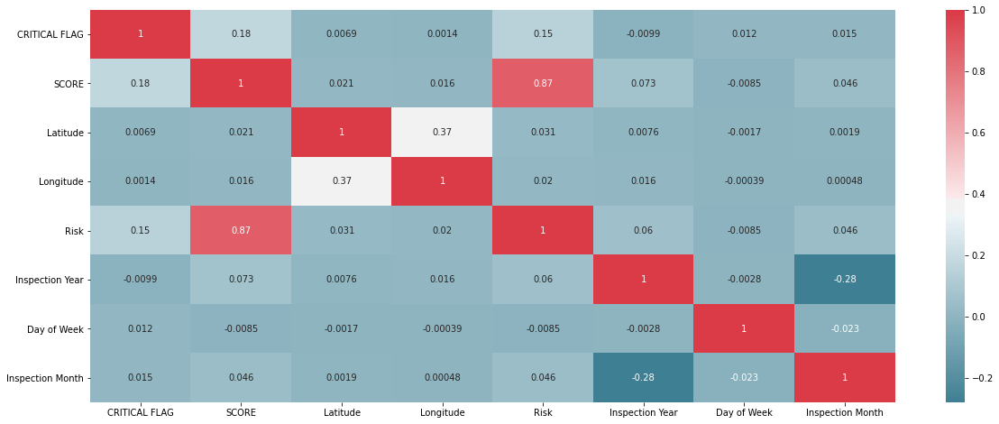

In [67]:
f, ax = plt.subplots(figsize=(20, 8))
corr = nyc_copy.corr()
sb.heatmap(corr, mask=np.zeros_like(corr,dtype=np.bool),cmap=sb.diverging_palette(220, 10, as_cmap=True),annot=True,ax=ax,);

In [68]:
nyc_copy.columns

Index(['CRITICAL FLAG', 'SCORE', 'Latitude', 'Longitude', 'Risk',
       'Inspection Year', 'Day of Week', 'Inspection Month'],
      dtype='object')

In [69]:
X = nyc_copy[['CRITICAL FLAG', 'SCORE', 'Latitude', 'Longitude',
       'Inspection Year', 'Day of Week', 'Inspection Month']] #--> This is the X in train test split
X.columns

Index(['CRITICAL FLAG', 'SCORE', 'Latitude', 'Longitude', 'Inspection Year',
       'Day of Week', 'Inspection Month'],
      dtype='object')

In [0]:
Y = nyc_copy['Risk']

In [0]:
# split the df into train and test in such a way so that these two don't communicate during the training

X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)

## Decision Tree Classifier Model

Let us create a decision tree classifier model to classify the restaurants inspected into their risk category

In [72]:
rest_tree = DecisionTreeClassifier(criterion="entropy", max_depth = 10, max_leaf_nodes=5)
rest_tree # it shows the default parameters

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=10, max_features=None, max_leaf_nodes=5,
                       min_impurity_decrease=0.0, min_impurity_split=None,
                       min_samples_leaf=1, min_samples_split=2,
                       min_weight_fraction_leaf=0.0, presort='deprecated',
                       random_state=None, splitter='best')

In [73]:
# Classifier Training

rest_tree.fit(X_train, y_train)

# Prediction on the test

predictions = rest_tree.predict(X_test)

# Accuracy of the prediction

metrics.accuracy_score(y_test, predictions)

1.0

Our model performs excellently. But this may overfit also. Let us use Random Forest Classsfier model to evaluate further.

## Random Forest Classifier Model

In [0]:
# Build a random forest

rf_tree = RandomForestClassifier(n_estimators = 1000, random_state = 42)

In [75]:
# Classifier Training
rf_tree.fit(X_train, y_train);

# Prediction on the test

predictions = rf_tree.predict(X_test)

# Accuracy of the prediction

metrics.accuracy_score(y_test, predictions)

1.0

There is no much difference between random forest and decision tree model. So let us now visualize a tree from random forest model.

In [76]:
# Visulaizing a tree

# Extract single tree
estimator = rf_tree.estimators_[5]

from sklearn.tree import export_graphviz
# Export as dot file
export_graphviz(estimator, out_file='tree.dot', 
                feature_names = X.columns,
                rounded = True, proportion = False, 
                precision = 2, filled = True)

import os
os.system('dot -Tpng tree.dot -o tree.png')

from IPython.display import Image
Image(filename = 'tree.png')

## Indian Restaurants in New York Visualization using Folium

In [77]:
address = 'New York City, NYC'

geolocator = Nominatim(user_agent="my-application")
location = geolocator.geocode(address)
latitude = location.latitude
longitude = location.longitude
print('The geograpical coordinate of New York City are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of New York City are 40.7127281, -74.0060152.


In [78]:
map_nyc = folium.Map(location=[latitude, longitude], zoom_start=10)

# add markers to map
for lat, lng, restaurant, street in zip(indian_df['Latitude'], indian_df['Longitude'], indian_df['DBA'], indian_df['STREET']):
    label = '{}, {}'.format(restaurant, street)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7, parse_html=False).add_to(map_nyc)  
    
map_nyc

In [79]:
# instantiate a feature group for the incidents in the dataframe
inspection = folium.map.FeatureGroup()

# loop through the 100 crimes and add each to the incidents feature group
for lat, lng, in zip(indian_df.Latitude, indian_df.Longitude):
    inspection.add_child(
        folium.CircleMarker(
            [lat, lng],
            radius=5, # define how big you want the circle markers to be
            color='yellow',
            fill=True,
            fill_color='blue',
            fill_opacity=0.6
        )
    )

# add pop-up text to each marker on the map
latitudes = list(indian_df.Latitude)
longitudes = list(indian_df.Longitude)
labels = list(indian_df['DBA'])

for lat, lng, label in zip(latitudes, longitudes, labels):
    folium.Marker([lat, lng], popup=label).add_to(map_nyc)    
    
# add incidents to map
map_nyc.add_child(inspection)

## Ratings of Indian Restaurants in New York using FourSquare API

**Using Four Square API to segment neighborhood**

In [0]:
# Define FourSquare Credentials

CLIENT_ID = 'CXLCHVQKEOLPOJAOCKYS1KPS3QSSMGH4KKCVXOXJ0FHK04CB' # your Foursquare ID
CLIENT_SECRET = 'JT1WOU5VT50X5PLHMNGJLXHOWJ3ZN5PETBK5PFDYPMS35KRK' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version
radius=1000
LIMIT=500
lat=40.7127281
lng=-74.0060152

In [0]:
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}&intent=match'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT,
            )
results = requests.get(url).json()

We define a function to interact with FourSquare API and get top 500 venues within a radius of 1000 metres for a given latitude and longitude. Below function will return us the venue id , venue name and category.

In [0]:
def getNearbyVenues(names, latitudes, longitudes):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
                        
        # make the GET request
        a = results['response']['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name'],
            v['venue']['id']) for v in a])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Restaurant Name', 
                  'Street Latitude', 
                  'Street Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category','Venue ID']
    
    return(nearby_venues)

In [0]:
# Load the above result into a new data frame
nyc_venues = getNearbyVenues(names=indian_df['DBA'],latitudes=indian_df['Latitude'],longitudes=indian_df['Longitude'])

In [86]:
nyc_venues.head()

,Restaurant Name,Street Latitude,Street Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Venue ID
0,AYNA AGRA,40.765365,-73.771666,The Bar Room at Temple Court,40.711448,-74.006802,Hotel Bar,57f0689d498e7d49d9189369
1,AYNA AGRA,40.765365,-73.771666,"The Beekman, A Thompson Hotel",40.711173,-74.006702,Hotel,56d8c0f8498edb854f926e6a
2,AYNA AGRA,40.765365,-73.771666,Alba Dry Cleaner & Tailor,40.711434,-74.006272,Laundry Service,4c606c3e1e5cd13ad1a1a1ed
3,AYNA AGRA,40.765365,-73.771666,City Hall Park,40.712415,-74.006724,Park,3fd66200f964a520d8f11ee3
4,AYNA AGRA,40.765365,-73.771666,The Class by Taryn Toomey,40.712753,-74.008734,Gym / Fitness Center,58a253c830ecc66c9e5b40a0


In [87]:
nyc_venues.shape

(288300, 8)

In [88]:
nyc_mod_df=nyc_mod_df.reset_index()
nyc_mod_df.drop(['index'],axis=1,inplace=True)
nyc_mod_df.head()

,CAMIS,DBA,BORO,BUILDING,STREET,ZIPCODE,PHONE,CUISINE DESCRIPTION,INSPECTION DATE,ACTION,VIOLATION CODE,VIOLATION DESCRIPTION,CRITICAL FLAG,SCORE,GRADE,GRADE DATE,RECORD DATE,INSPECTION TYPE,Latitude,Longitude,Community Board,Council District,Census Tract,BIN,BBL,NTA,Risk,Inspection Year,Day of Week
0,41582828,CIBO EXPRESS GOURMET MARKET/SALOTTO,Queens,0,LA GUARDIA AIRPORT,11369,3478675394,Sandwiches/Salads/Mixed Buffet,2020-02-06,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,2.0,A,02/06/2020,05/16/2020,Cycle Inspection / Initial Inspection,40.774414,-73.877293,480.0,21.0,33100.0,4000000.0,4.009260e+09,QN98,Low Risk,2020,3
1,50068643,RISBO,Brooklyn,701,FLATBUSH AVENUE,11225,3472259115,American,2019-03-21,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,7.0,A,03/21/2019,05/16/2020,Cycle Inspection / Initial Inspection,40.656011,-73.959948,309.0,40.0,79601.0,3115795.0,3.050480e+09,BK60,Low Risk,2019,3
2,41272855,BOBO RESTAURANT,Manhattan,181,WEST 10 STREET,10014,2124882626,French,2019-07-18,Violations were cited in the following area(s).,06C,Food not protected from potential source of co...,Y,10.0,A,07/18/2019,05/16/2020,Cycle Inspection / Re-inspection,40.734291,-74.002724,102.0,3.0,7300.0,1010840.0,1.006110e+09,MN23,Low Risk,2019,3
3,40394701,THE END ZONE BAR,Queens,14944,14 AVENUE,11357,7187469654,American,2019-01-29,Violations were cited in the following area(s).,08C,Pesticide use not in accordance with label or ...,N,13.0,A,01/29/2019,05/16/2020,Cycle Inspection / Re-inspection,40.788521,-73.815045,407.0,19.0,98100.0,4105612.0,4.046600e+09,QN49,Low Risk,2019,1
4,50064444,818 FAST FOOD,Brooklyn,818,NOSTRAND AVENUE,11216,3474353450,Chicken,2017-06-07,Violations were cited in the following area(s).,10F,Non-food contact surface improperly constructe...,N,8.0,A,06/07/2017,05/16/2020,Pre-permit (Operational) / Initial Inspection,40.670640,-73.950440,308.0,35.0,31702.0,3032632.0,3.012610e+09,BK61,Low Risk,2017,2


In [89]:
nyc_venues

,Restaurant Name,Street Latitude,Street Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Venue ID
0,AYNA AGRA,40.765365,-73.771666,The Bar Room at Temple Court,40.711448,-74.006802,Hotel Bar,57f0689d498e7d49d9189369
1,AYNA AGRA,40.765365,-73.771666,"The Beekman, A Thompson Hotel",40.711173,-74.006702,Hotel,56d8c0f8498edb854f926e6a
2,AYNA AGRA,40.765365,-73.771666,Alba Dry Cleaner & Tailor,40.711434,-74.006272,Laundry Service,4c606c3e1e5cd13ad1a1a1ed
3,AYNA AGRA,40.765365,-73.771666,City Hall Park,40.712415,-74.006724,Park,3fd66200f964a520d8f11ee3
4,AYNA AGRA,40.765365,-73.771666,The Class by Taryn Toomey,40.712753,-74.008734,Gym / Fitness Center,58a253c830ecc66c9e5b40a0
...,...,...,...,...,...,...,...,...
288295,AMMA,40.755984,-73.969243,Apothéke,40.714470,-73.998018,Cocktail Bar,48c91543f964a520e4511fe3
288296,AMMA,40.755984,-73.969243,Brookfield Place (BFPL),40.713240,-74.015193,Shopping Mall,4a6fa0abf964a520a4d61fe3
288297,AMMA,40.755984,-73.969243,Dig Inn,40.706285,-74.007011,American Restaurant,4a7ef289f964a52058f21fe3
288298,AMMA,40.755984,-73.969243,Fearless Girl,40.706772,-74.010963,Monument / Landmark,58c15cad4287c9455ad33fc8


In [90]:
print('There are {} uniques categories.'.format(len(nyc_venues['Venue Category'].unique())))

There are 65 uniques categories.


In [91]:
# Let's check how many venues were returned for each neighborhood

nyc_venues.groupby('Venue').count()

,Restaurant Name,Street Latitude,Street Longitude,Venue Latitude,Venue Longitude,Venue Category,Venue ID
Venue,,,,,,,
200 Water Street Rooftop,2883,2883,2883,2883,2883,2883,2883
9/11 Memorial North Pool,2883,2883,2883,2883,2883,2883,2883
9/11 Memorial South Pool,2883,2883,2883,2883,2883,2883,2883
9/11 Museum Auditorium,2883,2883,2883,2883,2883,2883,2883
Aire Ancient Baths,2883,2883,2883,2883,2883,2883,2883
...,...,...,...,...,...,...,...
Westfield World Trade Center,2883,2883,2883,2883,2883,2883,2883
Whole Foods Market,2883,2883,2883,2883,2883,2883,2883
Y7 Studio - Tribeca,2883,2883,2883,2883,2883,2883,2883


In [92]:
nyc_venues.shape

(288300, 8)

In [93]:
nyc_venues['Venue Category'].value_counts()

Coffee Shop                        25947
Gym                                11532
Gym / Fitness Center               11532
Park                                8649
American Restaurant                 8649
                                   ...  
General Entertainment               2883
Asian Restaurant                    2883
Molecular Gastronomy Restaurant     2883
Lounge                              2883
Discount Store                      2883
Name: Venue Category, Length: 65, dtype: int64

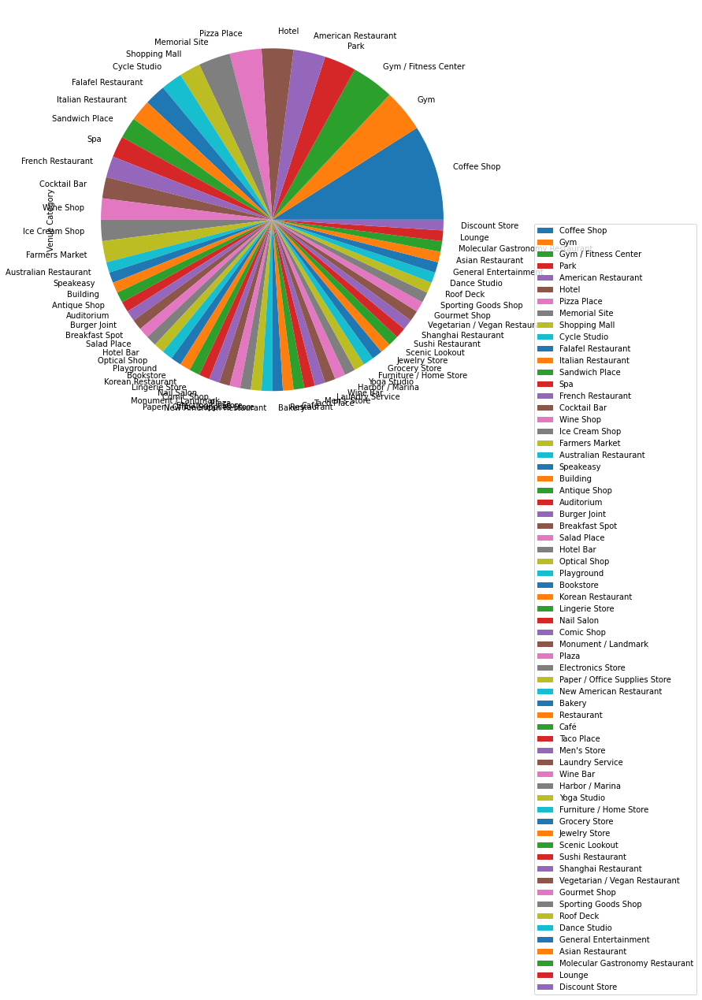

In [94]:
k=nyc_venues['Venue Category'].value_counts()
k.plot(kind='pie',figsize=(20,10),legend=True)
plt.legend(loc=0,bbox_to_anchor=(1.5,0.5));

In [95]:
nyc_venues['Restaurant Name'].value_counts()

NAMASTE                   3500
TIKKA INDIAN GRILL        3200
THE KATI ROLL COMPANY     3000
MUGHLAI INDIAN CUISINE    2900
CURRY IN A HURRY          2800
                          ... 
GARAM MASALA               200
NAAN STOP CURRY            200
MASTEE                     200
MADINA RESTAURANT          100
ADDA                       100
Name: Restaurant Name, Length: 283, dtype: int64

In [0]:
nyc_venues.to_csv('nyc_venues.csv', index=False)
from google.colab import files
files.download('nyc_venues.csv')

In [97]:
# work only with neighborhood contains indian restaurant

indian_rate_df=nyc_venues[nyc_venues['Restaurant Name'].str.contains("India")]
indian_rate_df

,Restaurant Name,Street Latitude,Street Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Venue ID
35700,Deep Indian Kitchen,40.765775,-73.983545,The Bar Room at Temple Court,40.711448,-74.006802,Hotel Bar,57f0689d498e7d49d9189369
35701,Deep Indian Kitchen,40.765775,-73.983545,"The Beekman, A Thompson Hotel",40.711173,-74.006702,Hotel,56d8c0f8498edb854f926e6a
35702,Deep Indian Kitchen,40.765775,-73.983545,Alba Dry Cleaner & Tailor,40.711434,-74.006272,Laundry Service,4c606c3e1e5cd13ad1a1a1ed
35703,Deep Indian Kitchen,40.765775,-73.983545,City Hall Park,40.712415,-74.006724,Park,3fd66200f964a520d8f11ee3
35704,Deep Indian Kitchen,40.765775,-73.983545,The Class by Taryn Toomey,40.712753,-74.008734,Gym / Fitness Center,58a253c830ecc66c9e5b40a0
...,...,...,...,...,...,...,...,...
281595,Deep Indian Kitchen,40.765775,-73.983545,Apothéke,40.714470,-73.998018,Cocktail Bar,48c91543f964a520e4511fe3
281596,Deep Indian Kitchen,40.765775,-73.983545,Brookfield Place (BFPL),40.713240,-74.015193,Shopping Mall,4a6fa0abf964a520a4d61fe3
281597,Deep Indian Kitchen,40.765775,-73.983545,Dig Inn,40.706285,-74.007011,American Restaurant,4a7ef289f964a52058f21fe3
281598,Deep Indian Kitchen,40.765775,-73.983545,Fearless Girl,40.706772,-74.010963,Monument / Landmark,58c15cad4287c9455ad33fc8


In [98]:
indian_rate_df['Venue Category'].value_counts()

Coffee Shop                117
Gym / Fitness Center        52
Gym                         52
American Restaurant         39
Pizza Place                 39
                          ... 
Discount Store              13
Salad Place                 13
Shanghai Restaurant         13
Lingerie Store              13
New American Restaurant     13
Name: Venue Category, Length: 65, dtype: int64

In [101]:
indian_res=indian_rate_df[indian_rate_df['Venue Category'].str.contains("Restaurant")]
indian_res

,Restaurant Name,Street Latitude,Street Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category,Venue ID
18,Deep Indian Kitchen,40.765775,-73.983545,Atera,40.716752,-74.005712,Molecular Gastronomy Restaurant,4f627061e4b05c1d57815977
19,Deep Indian Kitchen,40.765775,-73.983545,Juice Press,40.714788,-74.011132,Vegetarian / Vegan Restaurant,54148bc6498ea7bb8c05b70a
20,Deep Indian Kitchen,40.765775,-73.983545,Takahachi,40.716526,-74.008101,Sushi Restaurant,4a8f2f39f964a520471420e3
22,Deep Indian Kitchen,40.765775,-73.983545,Nish Nush,40.709418,-74.008056,Falafel Restaurant,564cb952498e133963c04186
23,Deep Indian Kitchen,40.765775,-73.983545,Little Park,40.715487,-74.009133,American Restaurant,545c0436498e798e22ce4b2a
...,...,...,...,...,...,...,...,...
1269,Deep Indian Kitchen,40.765775,-73.983545,La Parisienne,40.709423,-74.009992,French Restaurant,5a47a5e4e679bc7b226989ca
1273,Deep Indian Kitchen,40.765775,-73.983545,Crown Shy,40.706187,-74.007490,Restaurant,5c883f65f4b525002c0bf2ca
1279,Deep Indian Kitchen,40.765775,-73.983545,The Capital Grille,40.707903,-74.010086,American Restaurant,4aa8259ff964a5209b4f20e3
1290,Deep Indian Kitchen,40.765775,-73.983545,Jungsik,40.718695,-74.009070,Korean Restaurant,4e67f1c7d16433b90090c8f3


In [0]:
indian_res.reset_index(drop=True, inplace=True)
indian_res.head()

indian_res.to_csv('indian_restaurants.csv', index=False)
files.download('indian_restaurants.csv')

In [103]:
id_list = indian_res['Venue ID'].unique().tolist()
len(id_list)

18

Now we will define a function to get venue details like like count , rating , tip counts for a given venue id. This will be used for ranking.

In [0]:
def get_Venue_Details(venue_id):
  ratings_list = []
  
  # Create the API request URL
  url = 'https://api.foursquare.com/v2/venues/{}?&client_id={}&client_secret={}&v={}'.format(
            venue_id,
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION)
  # make the GET request
  results = requests.get(url).json()
  print(results)
  return(results)

In [0]:
ratings_list=[]
def venue_ratings():
    for item in id_list:
        rating_details=get_Venue_Details(item)
        venue_data=rating_details['response']
        try:
            venue_id=venue_data['venue']['id']
            venue_name=venue_data['venue']['name']
            venue_likes=venue_data['venue']['likes']['count']
            venue_rating=venue_data['venue']['rating']
            venue_tips=venue_data['venue']['tips']['count']
            ratings_list.append([venue_id,venue_name,venue_likes,venue_rating,venue_tips])
        except KeyError:
            pass
        column_names=['Venue ID','Venue Name','Venue Likes','Venue Rating','Venue Tips']
        df = pd.DataFrame(ratings_list,columns=column_names)
    return(df)

In [106]:
venue = venue_ratings()

{'meta': {'code': 200, 'requestId': '5ecfb0e39c6f59001b632cb2'}, 'response': {'venue': {'id': '4f627061e4b05c1d57815977', 'name': 'Atera', 'contact': {'phone': '2122261444', 'formattedPhone': '(212) 226-1444', 'twitter': 'ateranyc', 'instagram': 'ateranyc', 'facebook': '200781280029847', 'facebookName': 'Atera NYC'}, 'location': {'address': '77 Worth St', 'crossStreet': 'btwn Broadway & Church St', 'lat': 40.71675176130724, 'lng': -74.00571150855457, 'labeledLatLngs': [{'label': 'display', 'lat': 40.71675176130724, 'lng': -74.00571150855457}], 'postalCode': '10013', 'cc': 'US', 'city': 'New York', 'state': 'NY', 'country': 'United States', 'formattedAddress': ['77 Worth St (btwn Broadway & Church St)', 'New York, NY 10013', 'United States']}, 'canonicalUrl': 'https://foursquare.com/v/atera/4f627061e4b05c1d57815977', 'categories': [{'id': '4bf58dd8d48988d1c2941735', 'name': 'Molecular Gastronomy Restaurant', 'pluralName': 'Molecular Gastronomy Restaurants', 'shortName': 'Molecular Gastr

In [107]:
venue.head()

,Venue ID,Venue Name,Venue Likes,Venue Rating,Venue Tips
0,4f627061e4b05c1d57815977,Atera,183,8.9,44
1,54148bc6498ea7bb8c05b70a,Juice Press,86,9.2,12
2,4a8f2f39f964a520471420e3,Takahachi,311,8.9,80
3,564cb952498e133963c04186,Nish Nush,164,8.5,40
4,545c0436498e798e22ce4b2a,Little Park,467,8.4,108


In [0]:
venue.to_csv("Indian_Restaurants_Ratings.csv", index=False)
files.download("Indian_Restaurants_Ratings.csv")

In [112]:
restaurant_names = venue['Venue Name'].values.tolist()
restaurant_names

['Atera',
 'Juice Press',
 'Takahachi',
 'Nish Nush',
 'Little Park',
 'Maestro Pasta',
 'The Odeon',
 'Da Claudio',
 'Manhatta',
 'Two Hands Restaurant & Bar',
 'Khe-Yo',
 'Shanghai 21',
 'Taim',
 'La Parisienne',
 'Crown Shy',
 'The Capital Grille',
 'Jungsik',
 'Dig Inn']

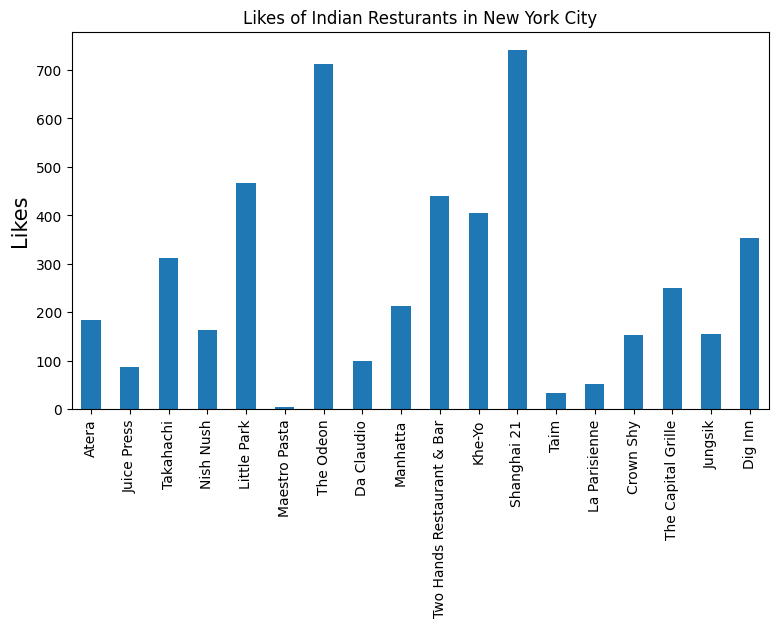

In [113]:
# Plot likes for each restaurant
plt.figure(figsize=(9,5), dpi = 100)

# title
plt.title('Likes of Indian Resturants in New York City')

#On y-axis
plt.ylabel('Likes', fontsize=15)

#giving a bar plot
venue['Venue Likes'].plot(kind='bar')

# set the locations and labels of the xticks
plt.xticks( np.arange(18), (restaurant_names), rotation=90)

#displays the plot
plt.show()

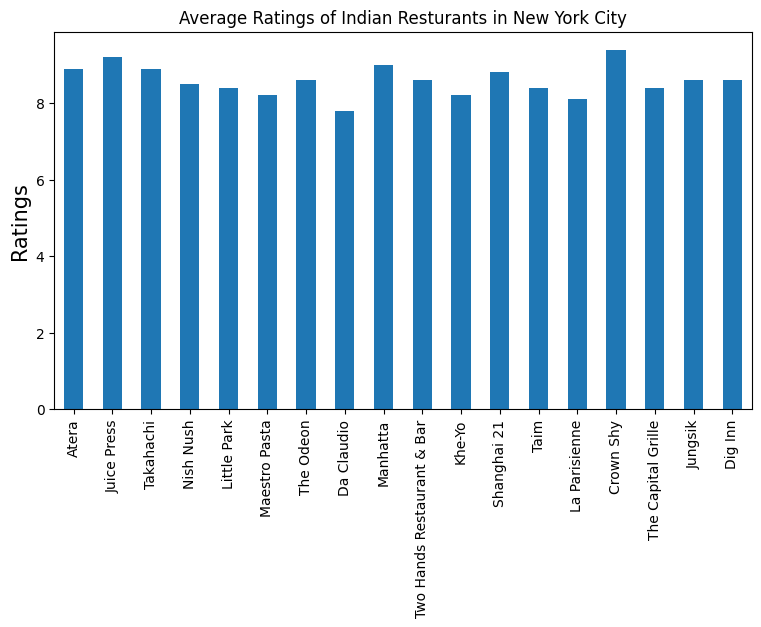

In [114]:
# Plot likes for each restaurant
plt.figure(figsize=(9,5), dpi = 100)

# title
plt.title('Average Ratings of Indian Resturants in New York City')

#On y-axis
plt.ylabel('Ratings', fontsize=15)

#giving a bar plot
venue['Venue Rating'].plot(kind='bar')

# set the locations and labels of the xticks
plt.xticks( np.arange(18), (restaurant_names), rotation=90 )

#displays the plot
plt.show()

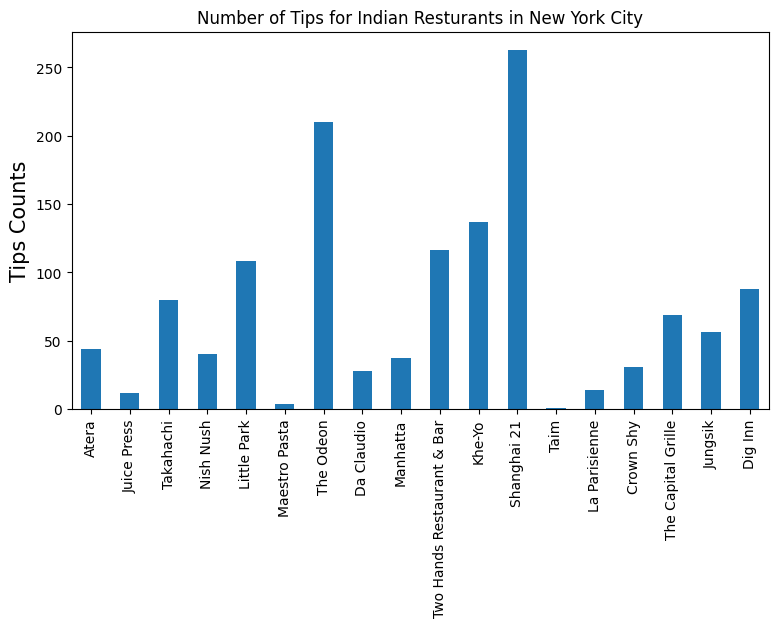

In [115]:
# Plot likes for each restaurant
plt.figure(figsize=(9,5), dpi = 100)

# title
plt.title('Number of Tips for Indian Resturants in New York City')

#On y-axis
plt.ylabel('Tips Counts', fontsize=15)

#giving a bar plot
venue['Venue Tips'].plot(kind='bar')

# set the locations and labels of the xticks
plt.xticks( np.arange(18), (restaurant_names), rotation=90 )

#displays the plot
plt.show()

## Conclusions

This project successfully completes my IBM Data Science Professional Certification Trianing.I have really enjoyed doing all the lab excersies and the courses were really informative. The following are the conclusions that I derive from this project:

*   New York has numerous Indian Restaurants out of which we have analyzed a few of them. Thus opening a restaurant in New York will be facing a tough competition in the beginning.

*   Of the Indian restaurants that are currently present in New York which we analyzed roughly 80%  are placed in low risk category based on the inspection data from 2016-2020

*   A decision tree classifier model is built for classifying the restaurants into various risk categories and the model performs well for the given data set. This will help the restaurants in predicting their risk category for a given year.

*   The Indian restaurants in the New York were visulaized using the folium map rendering library.

*   Using FourSquare API, the venue details for the Indian restaurants were analyzed and found that among all the restaurants in Shanghai 21 is the best place to dine.

## Limitations and Future Work

* The restaurants are ranked solely on the data provided by FourSquare API. If data on other demographics are available this can be improved
* The accuracy of location data depends on New York City Inspection Data and FourSquare API. Hence, need to be analyzed further as there are some ambiguous entries.
* The machine learning model will be further improved as the model developed is prone to over-fitting.